# Retrieval of A(C)³ scene March 13

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import iceMACS
import datetime
import os 
import xarray as xr
%load_ext autoreload
%autoreload 2

/usr/lib/python3/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


## Import and interpretation of SWIR data

Load bahamas data...
Load and calibrate SWIR data...
{'units': 'degree', 'long_name': 'central across track angle of given pixel'}
Load bahamas data...


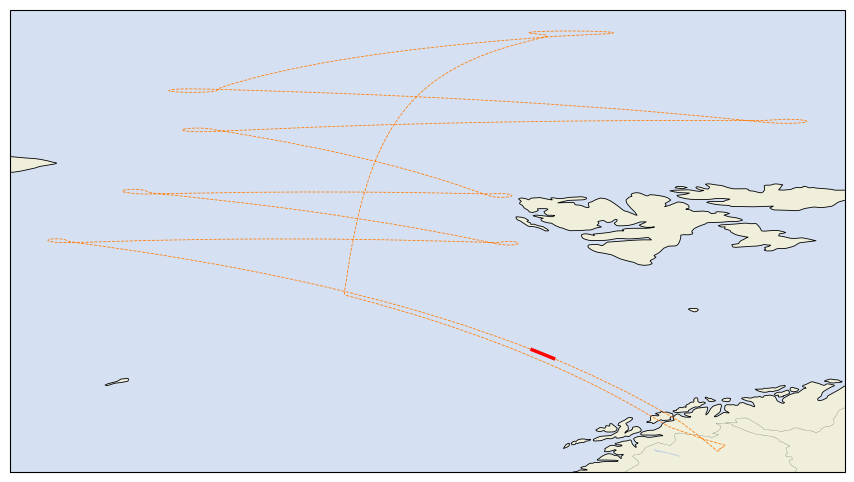

In [2]:
start_time = datetime.datetime(2022, 3, 13, 8, 52, 0)
end_time = datetime.datetime(2022, 3, 13, 8, 56, 5)

nas_scene, swir_scene_raw, vnir_scene_raw = iceMACS.load_AC3_scene(start_time, end_time, vnir=False)
iceMACS.map_AC3_scene(start_time, end_time)

In [3]:
#nas_scene_file_path = 'data/nas_scene.nc'
#iceMACS.save_as_netcdf(nas_scene, nas_scene_file_path)
#nas_scene = iceMACS.read_LUT(nas_scene_file_path)

In [4]:
swir_scene = swir_scene_raw.sel(wavelength=[1250, 1550, 1600, 1700], method='nearest').load()

In [5]:
interp = iceMACS.PixelInterpolator(swir_scene, window=2)

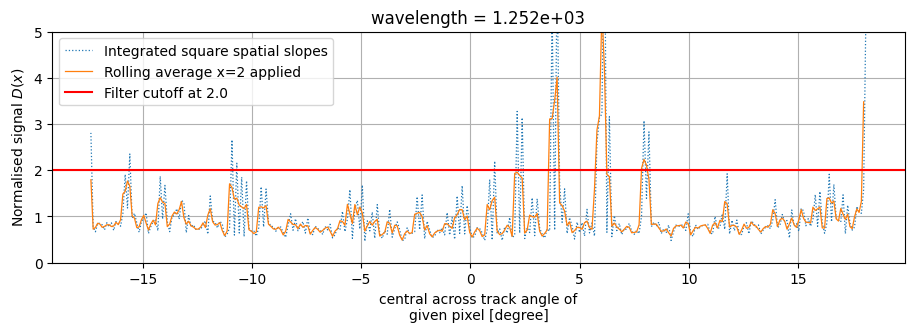

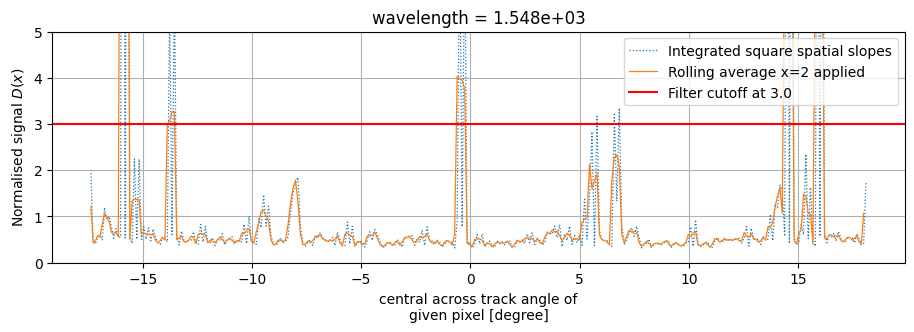

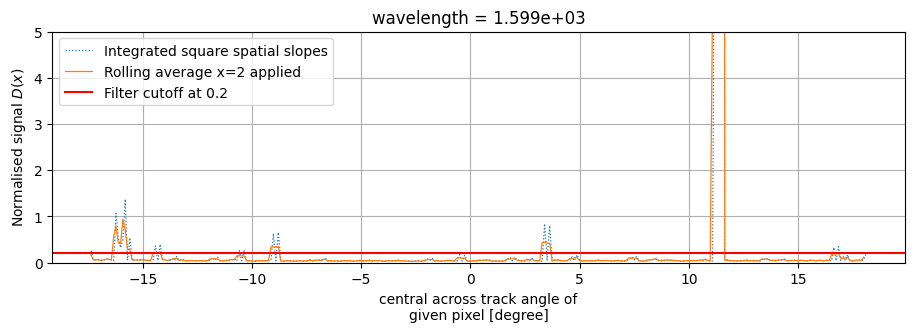

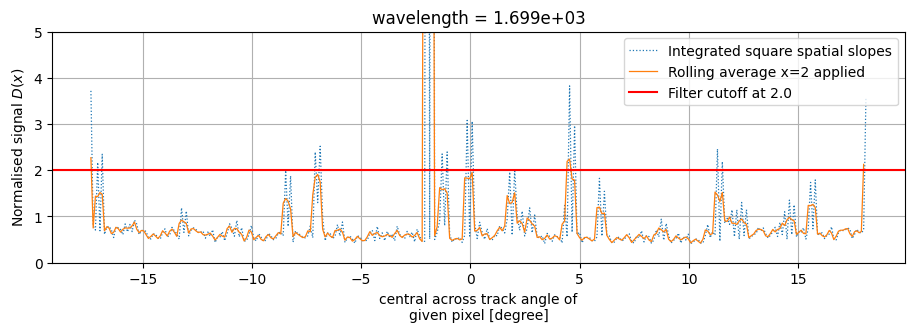

In [6]:
interp.add_cutoffs([2, 3, 0.2, 2])
interp.show_signals()

In [7]:
swir_scene['radiance'] = interp.filtered_radiance(remove=True)

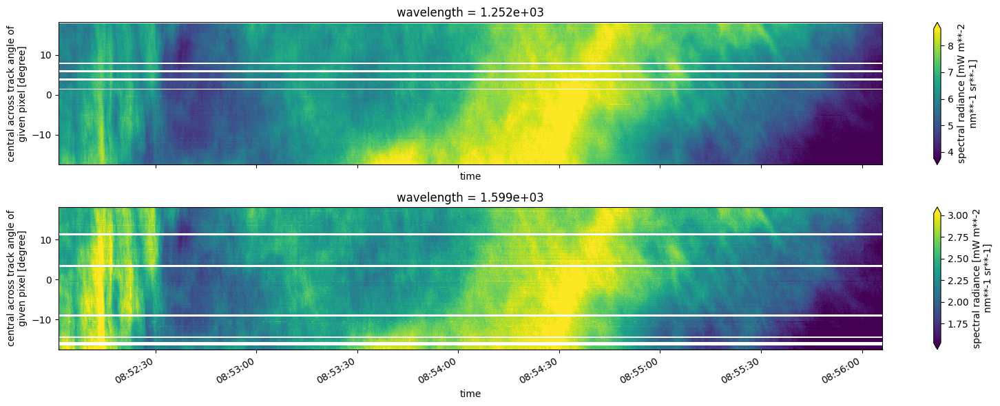

In [8]:
fig, ax = plt.subplots(nrows=2, figsize=(16,6), sharex=True)
swir_scene.radiance.sel(wavelength=1250, method='nearest').plot(x='time', robust=True, ax=ax[0])
swir_scene.radiance.sel(wavelength=1600, method='nearest').plot(x='time', robust=True, ax=ax[1])
plt.tight_layout()
#plt.savefig('scene.png')

In [9]:
#from macstrace.Halo import Halo
#halo = Halo.from_datasets('../mounttrees/ac3_mounttree.yaml', nas_scene, [swir_scene])#[vnir_scene, swir_scene])
#view_angles = halo.get_abs_view_angles('swir').isel(wavelength=0)
#iceMACS.save_as_netcdf(view_angles, 'data/view_angles.nc')

In [10]:
view_angles = iceMACS.read_LUT('data/view_angles.nc')

In [11]:
#solar_positions = iceMACS.get_solar_positions(nas_scene, '../mounttrees/ac3_mounttree.yaml')
#iceMACS.save_as_netcdf(solar_positions, 'data/solar_positions.nc')

In [12]:
solar_positions = iceMACS.read_LUT('data/solar_positions.nc')

In [13]:
from iceMACS.tools import SceneInterpreter
scene = SceneInterpreter(swir_scene, view_angles, solar_positions)

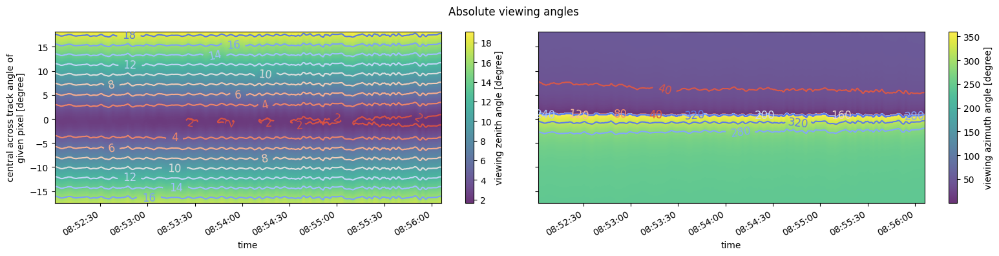

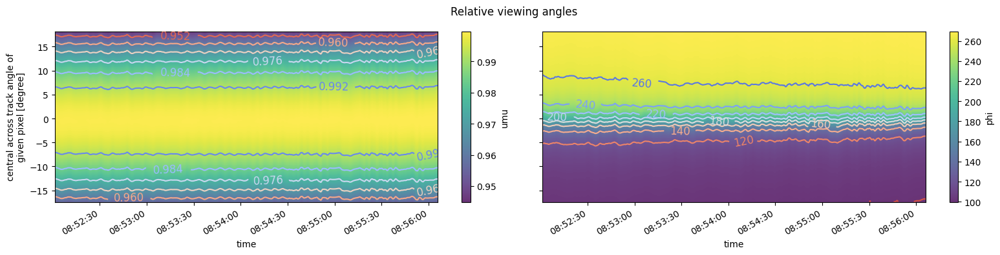

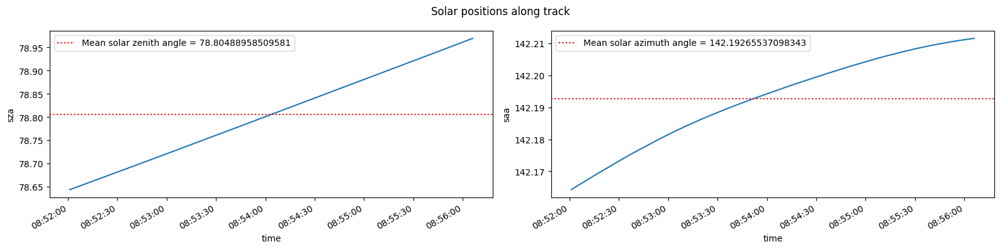

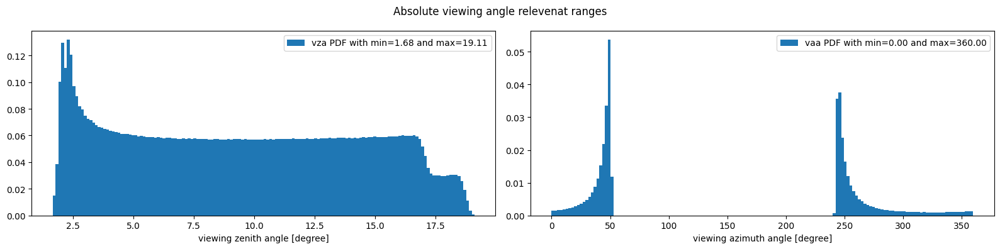

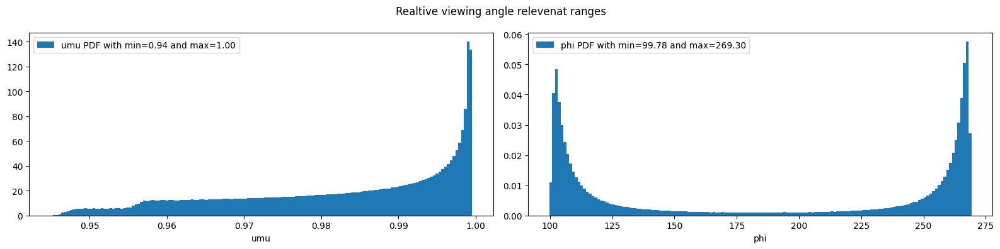

(array(78.80488959),
 array(142.19265537),
 array(0.94490486),
 array(0.99957124),
 array(99.78328074),
 array(269.29905082))

In [14]:
scene.overview()

In [15]:
#iceMACS.save_as_netcdf(swir_scene, 'data/SWIR_scene2.nc')

## LUT inversion and bispectral retrieval

In [16]:
LUT = BSRLookupTable.from_path('LUTsHALO-AC3_HALO_WALES_bsrgl_20220313_RF03_V2.0.nc/final/RF03_ghm_LUT.nc')
inverted = iceMACS.read_LUT("LUTs/final/RF03_ghm_LUT_inverted.nc")

In [27]:
inverted

<xarray.Dataset>
Dimensions:       (phi: 86, umu: 21, sza: 1, ic_habit: 1, R(1252.17nm): 200,
                   R(1598.57nm): 200, input_params: 2)
Coordinates:
  * phi           (phi) float64 99.0 101.0 103.0 105.0 ... 266.0 268.0 270.0
  * umu           (umu) float64 0.9397 0.9457 0.9513 0.9567 ... 0.9996 1.0 1.0
  * sza           (sza) float64 78.8
  * ic_habit      (ic_habit) object 'plate_10elements'
  * R(1252.17nm)  (R(1252.17nm)) float64 0.005171 0.007209 ... 0.4086 0.4106
  * R(1598.57nm)  (R(1598.57nm)) float64 0.002502 0.004234 ... 0.3454 0.3472
  * input_params  (input_params) object 'r_eff' 'tau550'
Data variables:
    reflectivity  (phi, umu, sza, ic_habit, R(1252.17nm), R(1598.57nm), input_params) float64 ...

In [20]:
directory_path = "LUTs/final/"
all_items = os.listdir(directory_path)

inverted_rough_LUTs = [directory_path+item
                       for item
                       in all_items if (item.startswith("RF03") and item.endswith("rough_LUT_inverted.nc"))]

rough_LUTs = [directory_path+item
              for item
              in all_items if (item.startswith("RF03") and item.endswith("rough_LUT.nc"))]

inverted_ghm_LUT = iceMACS.read_LUT('LUTs/final/RF03_ghm_LUT_inverted.nc')
inverted_ghm_LUT_ds = inverted_ghm_LUT.sel(umu=np.append(inverted_ghm_LUT.umu[::2],1), phi=inverted_ghm_LUT.phi[::2])

from iceMACS.tools import BSRLookupTable
ghm_LUT = BSRLookupTable.from_path('LUTs/final/RF03_ghm_LUT.nc')

In [5]:
directory_path = "LUTs/final/"
all_items = os.listdir(directory_path)

inverted_rough_LUTs = [directory_path+item
                       for item
                       in all_items if (item.startswith("RF03") and item.endswith("smooth_LUT_inverted.nc"))]

smooth_LUTs = [directory_path+item
              for item
              in all_items if (item.startswith("RF03") and item.endswith("smooth_LUT.nc"))]


cloud_property_list = [scene.cloud_properties_fast_BSR(inverted_ghm_LUT_ds, 1250, 1600, 
                                                       ghm_LUT.Rone_name, ghm_LUT.Rtwo_name,
                                                       umu_bins=30, phi_bins=100)]

for path in inverted_rough_LUTs:
    inverted = iceMACS.read_LUT(path)
    cloud_properties = scene.cloud_properties_fast_BSR(inverted, 1250, 1600, 
                                                       ghm_LUT.Rone_name, ghm_LUT.Rtwo_name,
                                                       umu_bins=30, phi_bins=100)
    cloud_property_list.append(cloud_properties)

In [23]:
merged_cloud_properties_smooth = xr.merge(cloud_property_list)

In [24]:
iceMACS.save_as_netcdf(merged_cloud_properties_smooth, "data/merged_cloud_properties_smooth.nc")

In [22]:
directory_path = "LUTs/final/"
all_items = os.listdir(directory_path)

from iceMACS.tools import BSRLookupTable
ghm_LUT = BSRLookupTable.from_path('LUTs/final/RF03_ghm_LUT.nc')

inverted_smooth_LUTs = [directory_path+item
                       for item
                       in all_items if (item.startswith("RF03") and item.endswith("smooth_LUT_inverted.nc"))]

smooth_LUTs = [directory_path+item
              for item
              in all_items if (item.startswith("RF03") and item.endswith("smooth_LUT.nc"))]


cloud_property_list = []

for path in inverted_smooth_LUTs:
    inverted = iceMACS.read_LUT(path)
    cloud_properties = scene.cloud_properties_fast_BSR(inverted, 1250, 1600, 
                                                       ghm_LUT.Rone_name, ghm_LUT.Rtwo_name,
                                                       umu_bins=30, phi_bins=100)
    cloud_property_list.append(cloud_properties)

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 90/100 [06:09<00:41,  4.20s/it]/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:564: RuntimeWarning: All-NaN slice encountered
  minval = np.nanmin(new_x.values)
/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:565: RuntimeWarning: All-NaN slice encountered
  maxval = np.nanmax(new_x.values)
/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:564: RuntimeWarning: All-NaN slice encountered
  minval = np.nanmin(new_x.values)
/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:565: RuntimeWarning: All-NaN slice encountered
  maxval = np.nanmax(new_x.values)
 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 90/100 [06:03<00:42,  4.27s/it]/home/d/Dennys.Erdtmann/

/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:564: RuntimeWarning: All-NaN slice encountered
  minval = np.nanmin(new_x.values)
/home/d/Dennys.Erdtmann/.local/lib/python3.8/site-packages/xarray/core/missing.py:565: RuntimeWarning: All-NaN slice encountered
  maxval = np.nanmax(new_x.values)
100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [07:48<00:00,  4.69s/it]


In [33]:
output = merged_cloud_properties#.coarsen(x=20, time=20, boundary='trim').mean()
for habit in output.ic_habit:
    output_sel = output.isel(time=slice(0, 727))
    print(habit.values.item(), xr.corr(output_sel.sel(ic_habit=habit).r_eff, output_sel.sel(ic_habit=habit).tau550).values.item())

column_8elements -0.47303066854294096
droxtal -0.5797076603329551
ghm -0.5131525085208761
hollow_bullet_rosette -0.464630649479207
hollow_column -0.5460411874949043
plate -0.4918703356582286
plate_10elements -0.6293216939804481
plate_5elements -0.5960031632012697
solid_bullet_rosette -0.3523369046465574
solid_column -0.5388031894341384


In [2]:
merged_cloud_properties = iceMACS.read_LUT("data/merged_cloud_properties.nc")

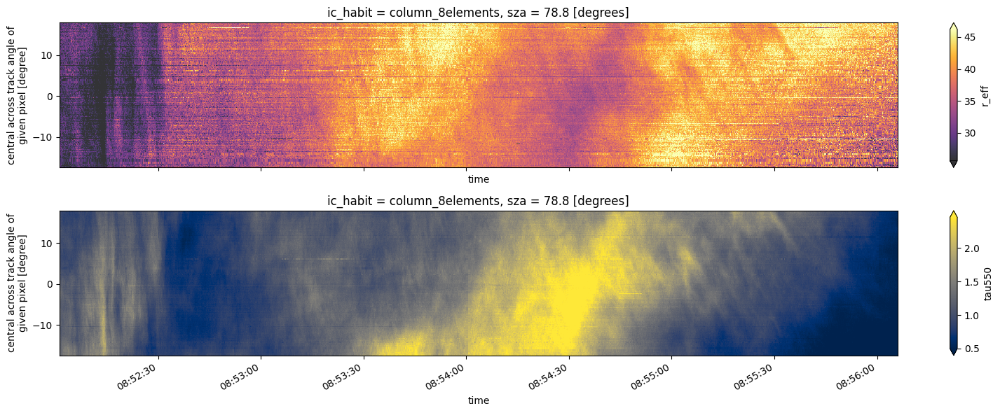

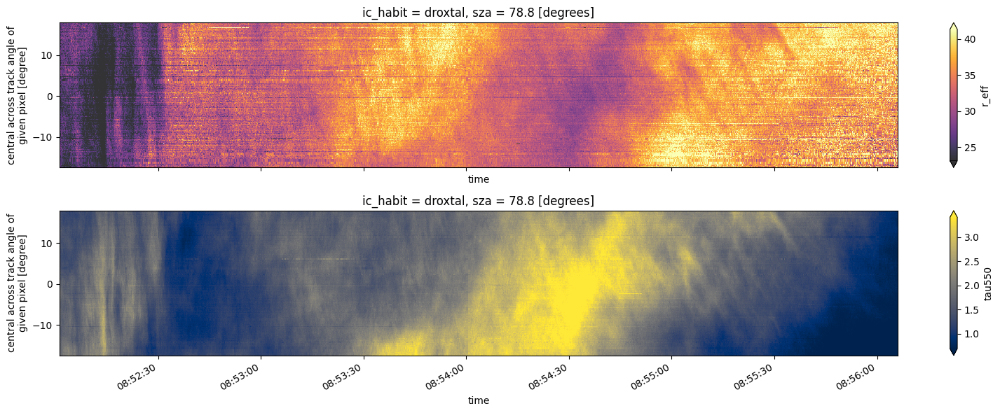

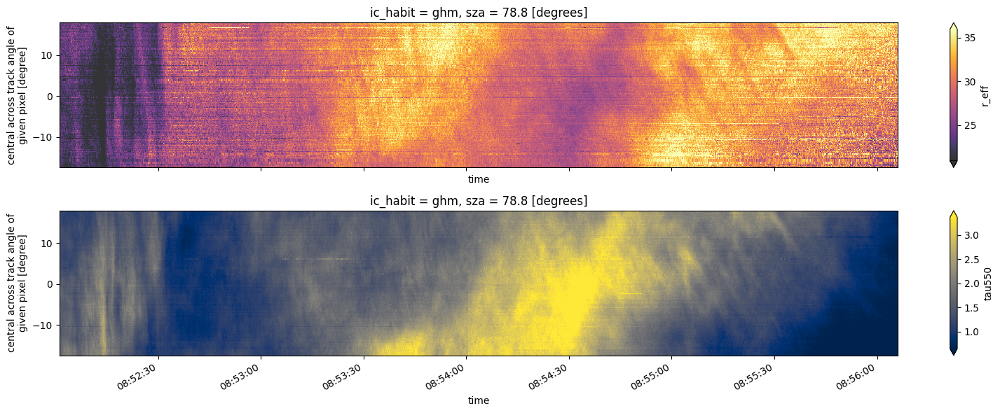

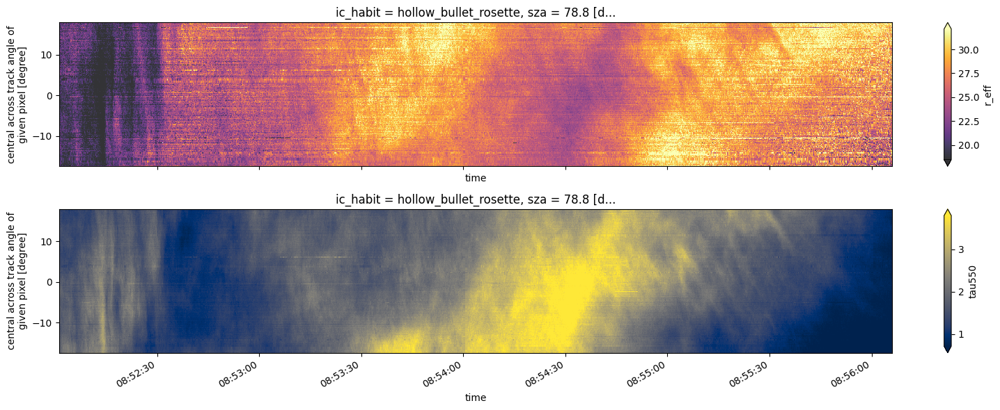

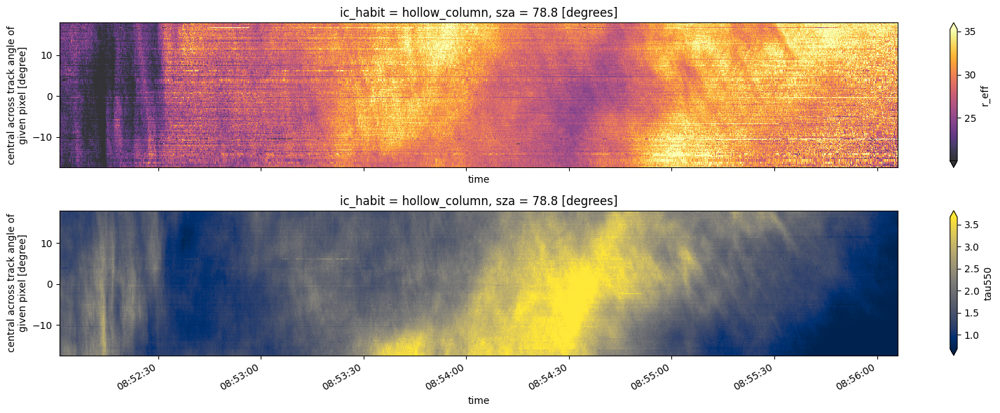

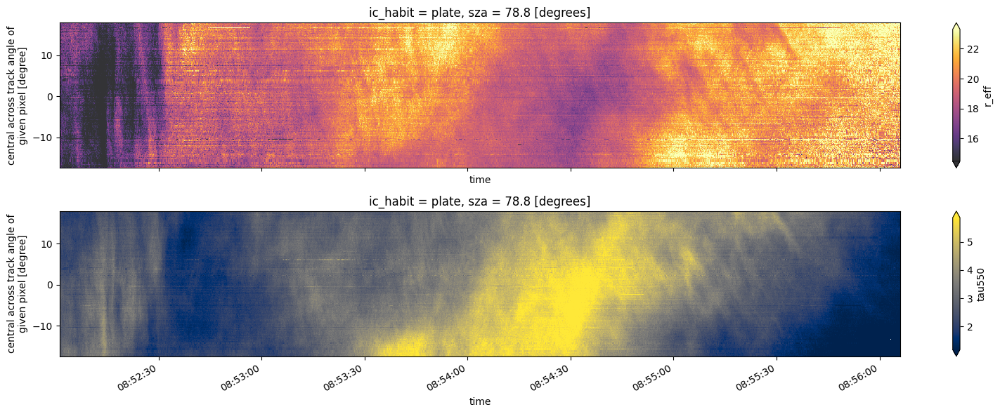

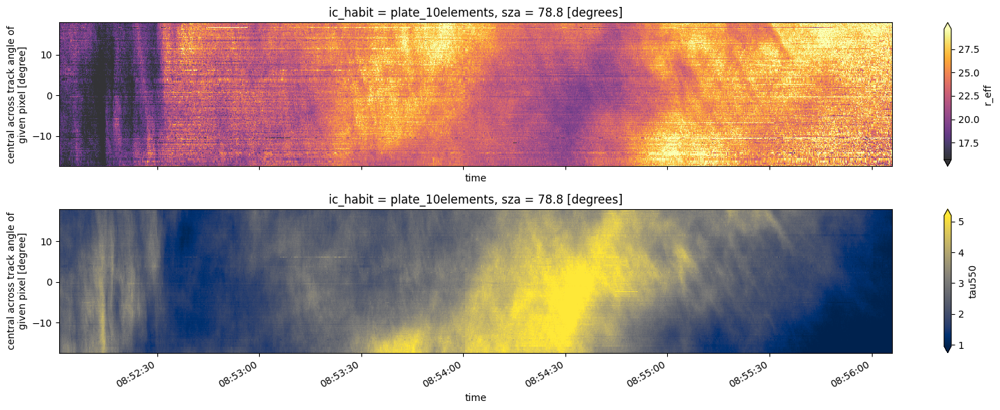

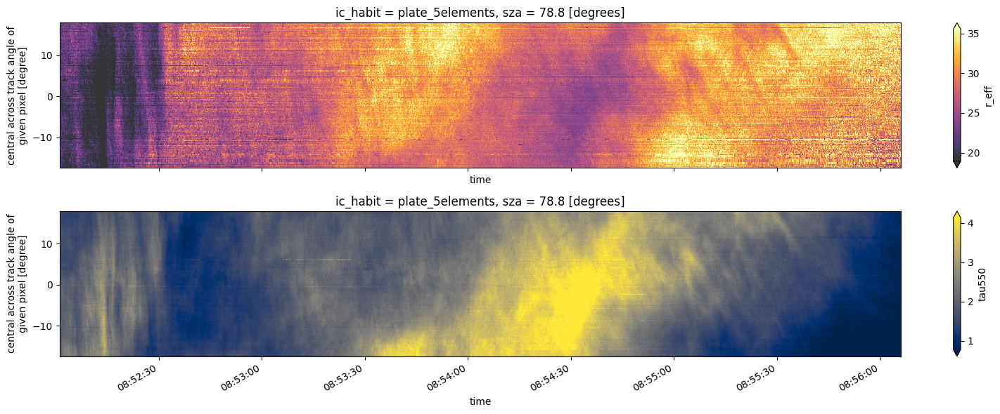

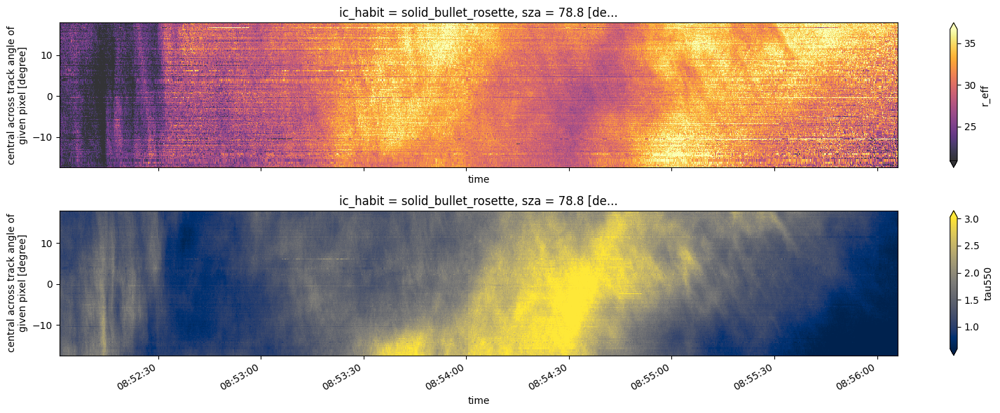

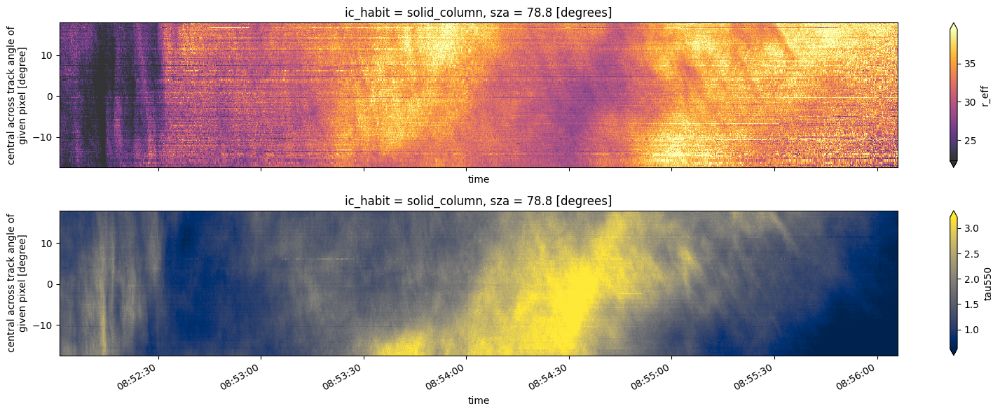

In [3]:
output = merged_cloud_properties#.coarsen(x=20, time=20, boundary='trim').mean()
for habit in output.ic_habit:

    fig, ax = plt.subplots(nrows=2, figsize=(16,6), sharex=True)

    #merged_data.reflectivity.sel(wavelength=1600, method='nearest').plot(cmap='Greys', ax=ax[0], add_colorbar=False)
    #output.sel(ic_habit=habit).r_eff.dropna(dim='x', how='all').plot(x='time', robust=True, ax=ax[0], cmap='Greys_r', add_colorbar=False, alpha=0.1)
    output.sel(ic_habit=habit).r_eff.dropna(dim='x', how='all').plot(x='time', robust=True, ax=ax[0], cmap='inferno', alpha=0.8)
    #merged_data.reflectivity.sel(wavelength=1250, method='nearest').plot(cmap='Greys', ax=ax[1], add_colorbar=False)
    output.sel(ic_habit=habit).tau550.dropna(dim='x', how='all').plot(x='time', robust=True, ax=ax[1], cmap='cividis')
    #scene.ice_index_Jaekel2013().interpolate_na(dim='x', use_coordinate=False).plot(robust=True, x='time')
    plt.tight_layout()
    #plt.savefig('retrieval_hd.pdf', bbox_inches='tight')

## Angular retrieval

In [16]:
pol = iceMACS.read_LUT('/scratch/v/Veronika.Poertge/ac3/cloudbow_retrieval_results_0_height_offset/concatenated_dennys_2_polb_with_latlonheight_with_viewing_angle.nc')
pol = pol.sel(color=0)

swir_coords = iceMACS.read_LUT('/project/meteo/work/Weber.Ann/PhD/swir_phase/coords3D/swir_3D_coords_latlonheight_cth_10km_2022-03-13T08:51:00_2022-03-13T08:56:04_new.nc')
inflight_B = iceMACS.read_LUT('../../mystic_tests/calibration_files/specMACS_POLB_cal_CHB2021+inflight.nc')

cloud_properties_rough = iceMACS.read_LUT('data/merged_cloud_properties_rough.nc').rolling(x=2, time=20).mean().where(scene.ice_index_Jaekel2013().rolling(x=2, time=2).mean()>1)
cloud_properties_smooth = iceMACS.read_LUT('data/merged_cloud_properties_smooth.nc').rolling(x=2, time=20).mean().where(scene.ice_index_Jaekel2013().rolling(x=2, time=2).mean()>1)

In [19]:
pol_ds = pol.sel(sample=pol.sample[::5])

# Allocate SWIR pixels and repsective cloud properties
from iceMACS.tools import PolSceneInterpreter
pol_scene = PolSceneInterpreter(pol_ds, nas_scene, solar_positions)

In [20]:
swir_time, swir_x = pol_scene.allocated_swir_coordinates(swir_coords)

r_eff_smooth, tau550_smooth = pol_scene.allocated_cloud_properties(cloud_properties_smooth, swir_coords)
r_eff_rough, tau550_rough = pol_scene.allocated_cloud_properties(cloud_properties_rough, swir_coords)

umu, phi = pol_scene.relative_view_angles()
vza, vaa = pol_scene.absolute_view_angles()

Number of iterations:  34560


34560it [29:54, 19.26it/s]
/project/meteo/work/Dennys.Erdtmann/Thesis/iceMACS/tools.py:602: UserWarning: Dimensions of swir coordinates and cloud properties do
                            not match! This will cause false assignment of 
                            SWIR data since locations are assigned by index, not value.
                            Coordinates will now be mapped onto cloud property grid.
  warnings.warn(r"""Dimensions of swir coordinates and cloud properties do
34560it [21:29, 26.81it/s]
/project/meteo/work/Dennys.Erdtmann/Thesis/iceMACS/tools.py:602: UserWarning: Dimensions of swir coordinates and cloud properties do
                            not match! This will cause false assignment of 
                            SWIR data since locations are assigned by index, not value.
                            Coordinates will now be mapped onto cloud property grid.
  warnings.warn(r"""Dimensions of swir coordinates and cloud properties do
8925it [05:32, 22.80it/s]

In [40]:
iceMACS.save_as_netcdf(xr.merge([swir_time, swir_x]), "data/swir_sample_coordinates.nc")
iceMACS.save_as_netcdf(r_eff_smooth, "data/r_eff_formatted_smooth.nc")
iceMACS.save_as_netcdf(tau550_smooth, "data/tau550_formatted_smooth.nc")
iceMACS.save_as_netcdf(r_eff_rough, "data/r_eff_formatted_rough.nc")
iceMACS.save_as_netcdf(tau550_smooth, "data/tau550_formatted_rough.nc")

# r_eff = iceMACS.read_LUT("data/r_eff_formatted_smooth.nc")
# tau550 = iceMACS.read_LUT("data/tau550_formatted_smooth.nc")

In [33]:
# Read MYSTIC simulations and compute reflectivity
polLUT = iceMACS.read_LUT('LUTs/mystic/RF03_pol_LUT_yang_smooth.nc')

from iceMACS.tools import PolLookupTable
polLUT_interp=PolLookupTable(polLUT)

#sim = xr.merge([polLUT_interp.calibrated_polarized_reflectivity(inflight_B),
 #               polLUT])
    
sim = polLUT_interp.calibrated_polarized_reflectivity(inflight_B)

#refine resolution in cloud properties
r_eff_hd = np.linspace(sim.r_eff.min(), sim.r_eff.max(), num=50)
tau_hd = np.linspace(sim.tau550.min(), sim.tau550.max(), num=100)
sim_hd = sim.rolling(tau550=2).mean().interp(r_eff=r_eff_hd, tau550=tau_hd)

# choose simulated habits
r_eff_sel = r_eff_smooth.sel(ic_habit = sim_hd.ic_habit)
tau550_sel = tau550_smooth.sel(ic_habit = sim_hd.ic_habit)

# project LUT on measured dataset
sim_formatted = (sim_hd
                 .sel(r_eff=r_eff_sel, method='nearest').sel(tau550=tau550_sel, method='nearest')
                 .sel(sza=pol_scene.solar_positions.sza.mean(), method='nearest'))

sim_formatted_smooth = sim_formatted.interp(umu=umu, phi=phi)
                 
#sim_formatted = sim_formatted.where(sim_formatted.r_eff!=60)#.where(tau550_sel.tau550 != np.nan)

In [34]:
# Read MYSTIC simulations and compute reflectivity
polLUT = iceMACS.read_LUT('LUTs/mystic/RF03_pol_LUT_yang_rough.nc')

from iceMACS.tools import PolLookupTable
polLUT_interp=PolLookupTable(polLUT)

#sim = xr.merge([polLUT_interp.calibrated_polarized_reflectivity(inflight_B),
 #               polLUT])
    
sim = polLUT_interp.calibrated_polarized_reflectivity(inflight_B)

#refine resolution in cloud properties
r_eff_hd = np.linspace(sim.r_eff.min(), sim.r_eff.max(), num=50)
tau_hd = np.linspace(sim.tau550.min(), sim.tau550.max(), num=100)
sim_hd = sim.rolling(tau550=2).mean().interp(r_eff=r_eff_hd, tau550=tau_hd)

# choose simulated habits
r_eff_sel = r_eff_rough.sel(ic_habit = sim_hd.ic_habit)
tau550_sel = tau550_rough.sel(ic_habit = sim_hd.ic_habit)

# project LUT on measured dataset
sim_formatted = (sim_hd
                 .sel(r_eff=r_eff_sel, tau550=tau550_sel, method='nearest')
                 .sel(sza=pol_scene.solar_positions.sza.mean(), method='nearest'))

sim_formatted_rough = sim_formatted.interp(umu=umu, phi=phi)
                 
#sim_formatted = sim_formatted.where(sim_formatted.r_eff!=60)#.where(tau550_sel.tau550 != np.nan)

In [35]:
iceMACS.save_as_netcdf(sim_formatted_rough, "data/sim_formatted_rough.nc")
iceMACS.save_as_netcdf(sim_formatted_smooth, "data/sim_formatted_smooth.nc")

In [38]:
sim_formatted_rough = iceMACS.read_LUT("data/sim_formatted_rough.nc")

In [38]:
absolute_signal_rough = sim_formatted_rough
relative_signal_rough = absolute_signal_rough/absolute_signal_rough.mean(dim='theta_mean')

absolute_signal_smooth = sim_formatted_smooth
relative_signal_smooth = absolute_signal_smooth/absolute_signal_smooth.mean(dim='theta_mean')

absolute_measured_reflectivity = pol_scene.polarized_reflectivity(inflight_B).sel(color='red', sample=pol_ds.sample)
relative_measured_reflectivity = absolute_measured_reflectivity/absolute_measured_reflectivity.mean(dim="theta_mean")

In [36]:
diffs = np.square(rescaled_meas_ref - rescaled_sim_ref).mean(dim='theta_mean').mean(dim='sample')

AttributeError: 'DataArray' object has no attribute 'simulated_reflectivity'

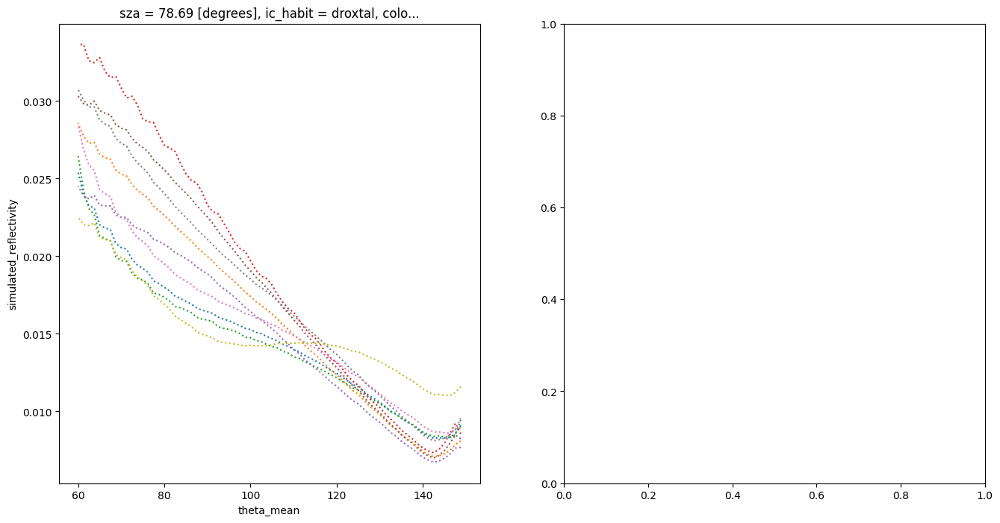

In [39]:
fig, ax = plt.subplots(ncols=2, figsize=(16,8))

for habit in sim_formatted.ic_habit:
    (absolute_signal_rough.mean(dim='sample')
     .sel(ic_habit=habit)).plot(label=habit.values, linestyle='dotted', ax=ax[0])
    
absolute_measured_reflectivity.where(sim_formatted.simulated_reflectivity.isel(ic_habit=0) != np.nan).mean(dim='sample').plot(label='measurement', ax=ax[0],color='black')
ax[0].legend()
ax[0].set_title("Absolute signals")

for habit in sim_formatted.ic_habit:
    (sim_formatted.simulated_reflectivity
     .mean(dim='sample')
     .sel(ic_habit=habit)
     /sim_formatted
     .simulated_reflectivity
     .mean(dim='sample')
     .sel(ic_habit=habit)
     .mean()).plot(label=habit.values, linestyle='dotted', ax=ax[1])
    
(pol_scene.polarized_reflectivity(inflight_B)
 .sel(color='red').mean(dim='sample')
 /pol_scene.polarized_reflectivity(inflight_B)
 .sel(color='red').mean(dim='sample')
 .mean()).plot(label='measurement', ax=ax[1])
ax[1].set_title("Normalized signals")
ax[1].legend()

plt.tight_layout()
#plt.savefig("habit_retrieval_reflectivity_demo_new.png")

## Resolution study

In [22]:
output_hd = scene.cloud_properties_fast_BSR(inverted_hd, 
                                                  1250, 2150, LUT.Rone_name, LUT.Rtwo_name, 
                                                          umu_bins=40, phi_bins=120, interpolate=False)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 120/120 [09:29<00:00,  4.75s/it]


In [23]:
inverted_half_both = inverted_hd.sel(phi=inverted_hd['phi'][::2], umu=inverted_hd['umu'][::2])
output_half_both_interp = scene.cloud_properties_fast_BSR(inverted_half_both, 
                                                  1250, 2150, LUT.Rone_name, LUT.Rtwo_name, 
                                                          umu_bins=20, phi_bins=60, interpolate=True)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 60/60 [02:50<00:00,  2.85s/it]


In [24]:
output_half_both_correct = scene.cloud_properties_fast_BSR(inverted_half_both, 
                                                  1250, 2150, LUT.Rone_name, LUT.Rtwo_name, 
                                                           umu_bins=20, phi_bins=60, interpolate=False)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 60/60 [02:45<00:00,  2.76s/it]


In [52]:
merged_data = scene.merged_data()

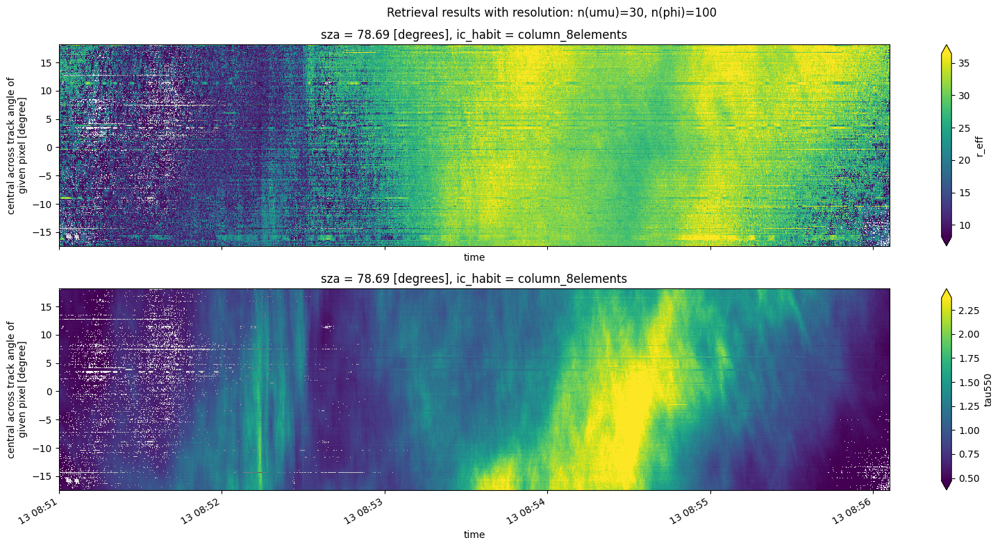

In [53]:
output = cloud_properties
habit = 'column_8elements'

fig, ax = plt.subplots(nrows=2, figsize=(16,8), sharex=True)

merged_data.reflectivity.sel(wavelength=1600, method='nearest').plot(cmap='Greys', ax=ax[0], add_colorbar=False)
output.sel(ic_habit=habit).r_eff.plot(x='time', robust=True, ax=ax[0])
merged_data.reflectivity.sel(wavelength=1250, method='nearest').plot(cmap='Greys', ax=ax[1], add_colorbar=False)
output.sel(ic_habit=habit).tau550.plot(x='time', robust=True, ax=ax[1])
plt.tight_layout()
#plt.savefig('retrieval_hd.png', bbox_inches='tight')

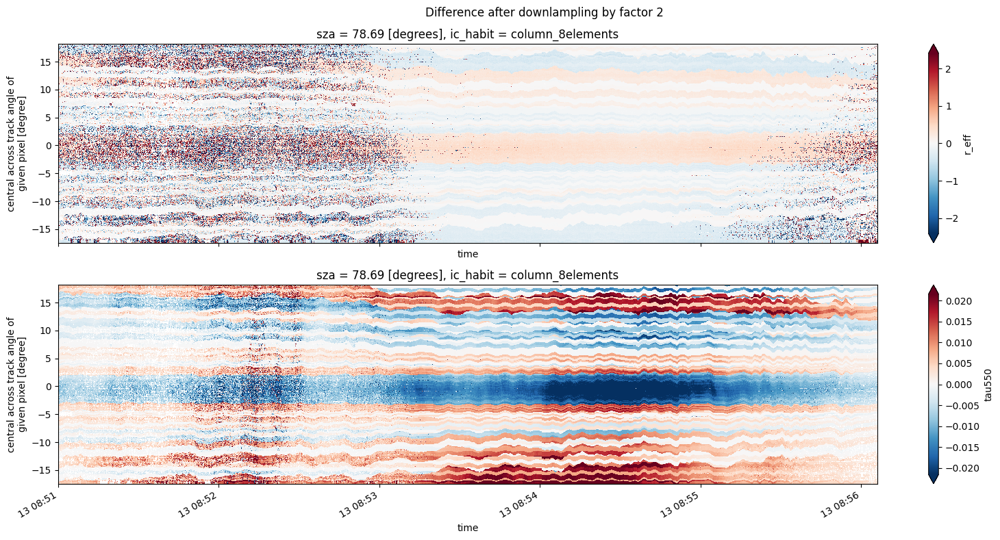

In [43]:
output = (output_hd - output_half_both_correct)
habit = 'column_8elements'

fig, ax = plt.subplots(nrows=2, figsize=(16,8), sharex=True)

output.sel(ic_habit=habit).r_eff.plot(x='time', robust=True, ax=ax[0])
output.sel(ic_habit=habit).tau550.plot(x='time', robust=True, ax=ax[1])

fig.suptitle("Difference after downlampling by factor 2")
plt.tight_layout()
plt.savefig('error_half_both.png', bbox_inches='tight')

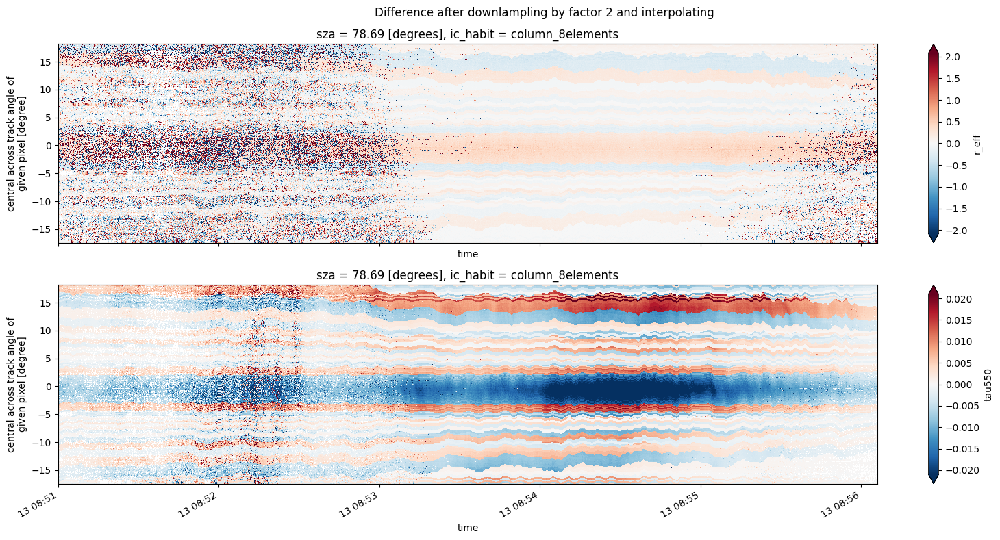

In [44]:
output = (output_hd - output_half_both_interp)
habit = 'column_8elements'

fig, ax = plt.subplots(nrows=2, figsize=(16,8), sharex=True)

output.sel(ic_habit=habit).r_eff.plot(x='time', robust=True, ax=ax[0])
output.sel(ic_habit=habit).tau550.plot(x='time', robust=True, ax=ax[1])

fig.suptitle("Difference after downlampling by factor 2 and interpolating")
plt.tight_layout()
plt.savefig('error_half_both_interp.png', bbox_inches='tight')

In [45]:
RMS_downsampled = np.sqrt(np.square((output_hd - output_half_both_correct).sel(ic_habit=habit)).mean())

In [46]:
RMS_downsampled

<xarray.Dataset>
Dimensions:   ()
Coordinates:
    sza       float64 78.69
    ic_habit  <U16 'column_8elements'
Data variables:
    r_eff     float64 0.9266
    tau550    float64 0.009296

In [47]:
RMS_interp = np.sqrt(np.square((output_hd - output_half_both_interp).sel(ic_habit=habit)).mean())

In [48]:
RMS_interp

<xarray.Dataset>
Dimensions:   ()
Coordinates:
    sza       float64 78.69
    ic_habit  <U16 'column_8elements'
Data variables:
    r_eff     float64 0.805
    tau550    float64 0.007839

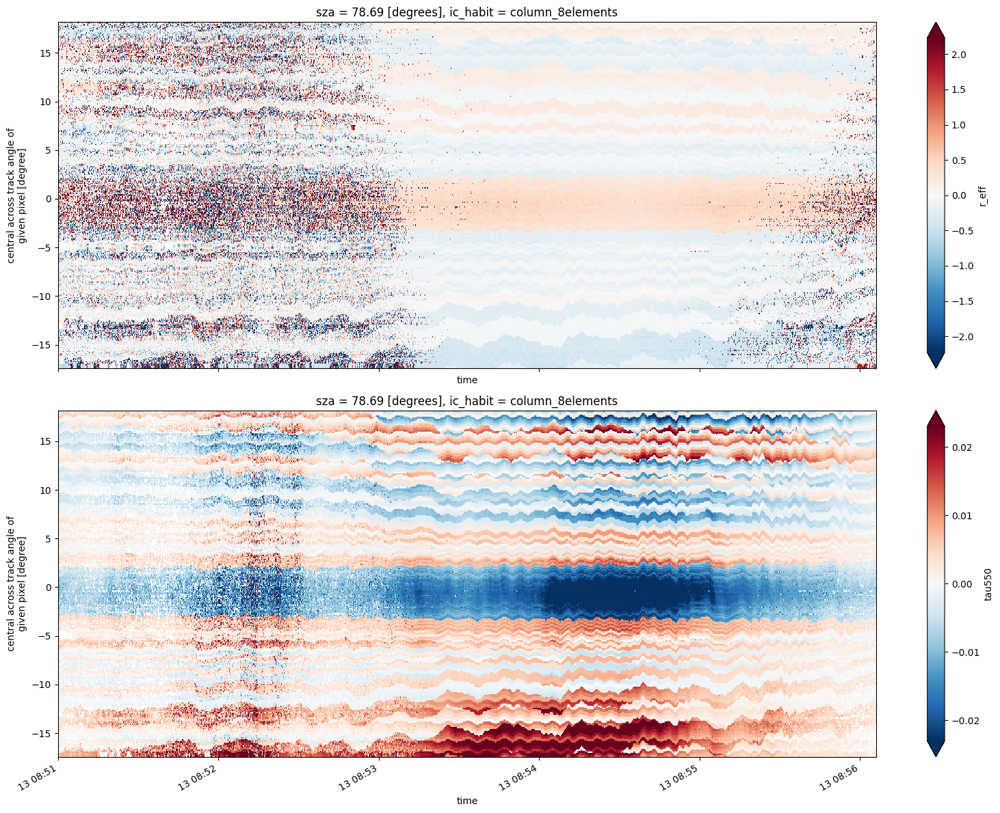

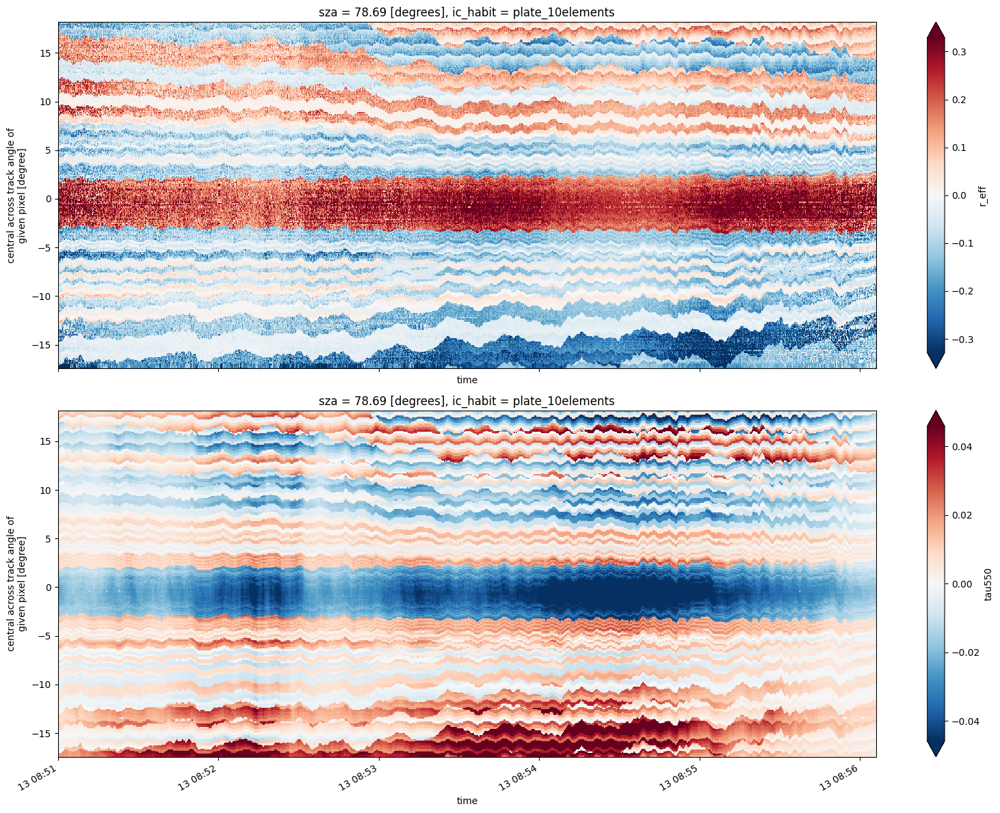

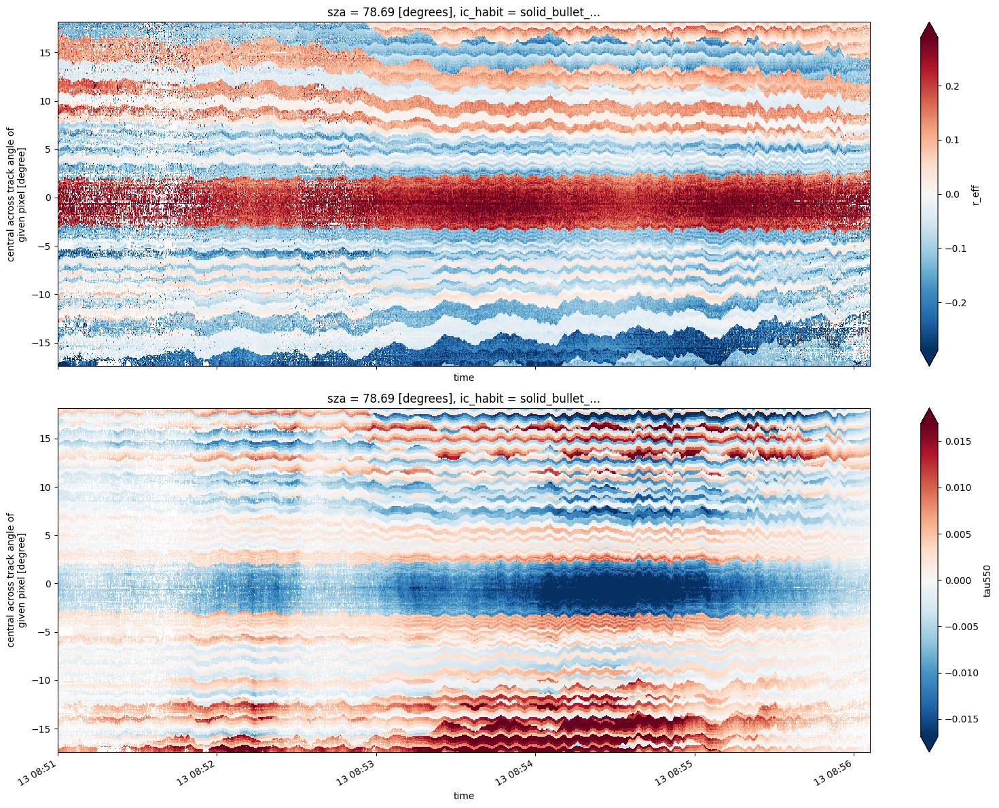

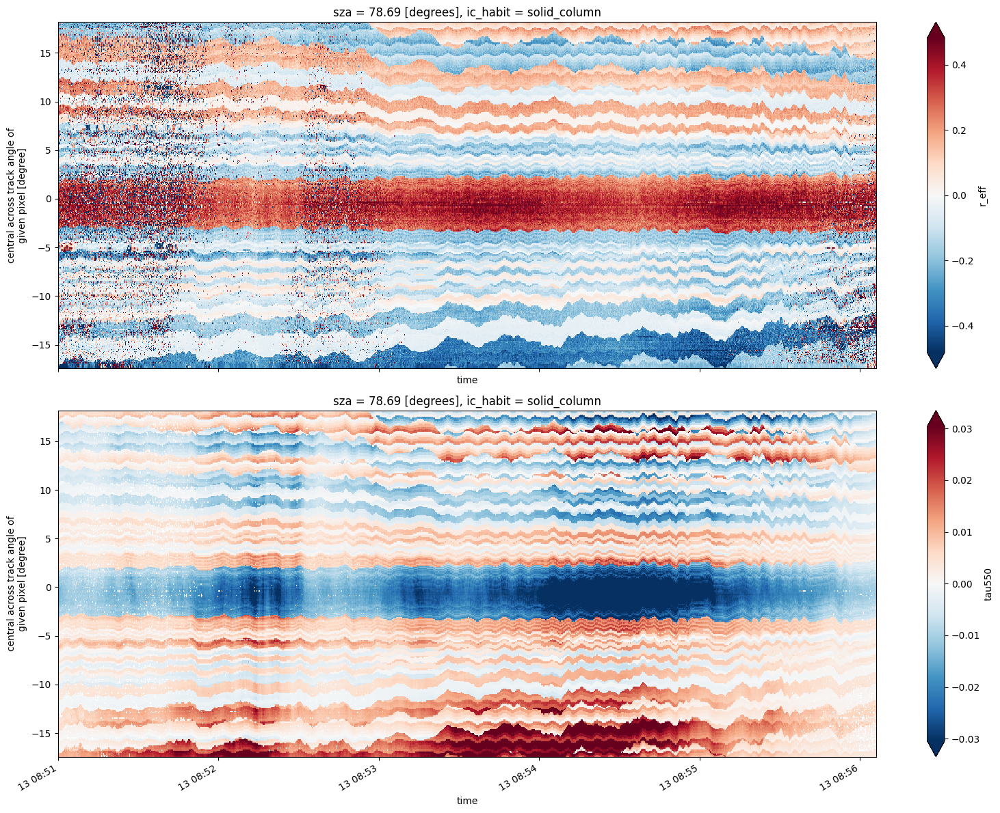

In [21]:
output = (output_half_both_interp - output_half_both_correct)
#output = output_hd
for habit in output_hd.ic_habit:
    fig, ax = plt.subplots(nrows=2, figsize=(16,12), sharex=True)
    output.sel(ic_habit=habit).r_eff.plot(x='time', robust=True, ax=ax[0])
    output.sel(ic_habit=habit).tau550.plot(x='time', robust=True, ax=ax[1])
    plt.tight_layout()

## Data with lat-lon coords

In [32]:
da = iceMACS.read_LUT('/project/meteo/work/Weber.Ann/PhD/swir_phase/coords3D/swir_3D_coords_latlonheight_cth_10km_2022-03-13T08:52:01_2022-03-13T08:56:04.nc')

In [41]:
scene.merged_data()

<xarray.Dataset>
Dimensions:       (x: 320, wavelength: 4, time: 7272)
Coordinates:
  * x             (x) float64 18.11 18.0 17.9 17.8 ... -17.17 -17.27 -17.38
  * wavelength    (wavelength) float64 1.252e+03 1.548e+03 1.599e+03 1.699e+03
  * time          (time) datetime64[ns] 2022-03-13T08:52:01.200988 ... 2022-0...
Data variables:
    radiance      (x, wavelength, time) float64 6.15 6.029 5.939 ... 1.119 1.209
    alt           (x, wavelength) float64 -0.002035 -0.002714 ... -0.001882
    act           (x, wavelength) float64 18.11 18.12 18.12 ... -17.39 -17.39
    valid         (x, wavelength) uint8 1 1 1 1 1 1 1 1 1 ... 1 1 1 1 1 1 1 1 1
    umu           (time, x) float64 0.9478 0.9484 0.9489 ... 0.956 0.9555 0.955
    phi           (time, x) float64 267.2 267.1 267.1 ... 99.85 99.82 99.78
    reflectivity  (x, wavelength, time) float64 0.2196 0.2153 ... 0.09397
    sza           (time) float64 78.64 78.64 78.64 78.64 ... 78.97 78.97 78.97
    saa           (time) float64 142.2 142.2 142.2 142.2 ... 142.2 142.2 142.2
    d             (time) float64 0.9938 0.9938 0.9938 ... 0.9938 0.9938 0.9938
    vaa           (time, x) float64 49.35 49.31 49.27 ... 242.0 242.0 242.0
    vza           (time, x) float64 18.59 18.49 18.39 ... 17.05 17.16 17.26
Attributes:
    source_name:  swir
    sw_vers:      DAQ sw ver 0.3 (c++/roc)
    user_meta:    {"captureId":"32d67221-7246-4b5d-8d80-ac148edfd014","userMe...

In [43]:
import xarray as xr

In [44]:
iceMACS.save_as_netcdf(xr.merge([scene.merged_data(), da]), 'data/merged_data_RF03.nc')

In [46]:
print(da)

<xarray.Dataset>
Dimensions:  (x: 320, time: 7242)
Coordinates:
  * x        (x) float64 18.11 18.0 17.9 17.8 ... -17.07 -17.17 -17.27 -17.38
  * time     (time) datetime64[ns] 2022-03-13T08:52:01.200988 ... 2022-03-13T...
Data variables:
    lat      (x, time) float64 ...
    lon      (x, time) float64 ...
    height   (x, time) float64 ...
